<a href="https://colab.research.google.com/github/magenta/midi-ddsp/blob/main/midi_ddsp/colab/MIDI_DDSP_Demo.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##### Copyright 2022 The MIDI-DDSP Authors.

Licensed under the Apache License, Version 2.0 (the "License");





In [1]:
#@title
#  Copyright 2022 The MIDI-DDSP Authors.
#  #
#  Licensed under the Apache License, Version 2.0 (the "License");
#  you may not use this file except in compliance with the License.
#  You may obtain a copy of the License at
#  #
#      http://www.apache.org/licenses/LICENSE-2.0
#  #
#  Unless required by applicable law or agreed to in writing, software
#  distributed under the License is distributed on an "AS IS" BASIS,
#  WITHOUT WARRANTIES OR CONDITIONS OF ANY KIND, either express or implied.
#  See the License for the specific language governing permissions and
#  limitations under the License.

If imports don't work, try this:

In [2]:
# !conda install nvidia/label/cuda-11.8.0::cuda-toolkit
# !conda install ipython ipykernel
# !pip install midi-ddsp
# !pip install ipywidgets===7.0.1
# !pip install ipython_genutils
# !pip install numpy==1.23.0
# !pip install -q git+https://github.com/lukewys/qgrid.git


# MIDI-DDSP Demo
Here is the demo where you can automatically synthesize MIDI with the proposed model and then edit the note expression controls of each note. This can be seen as a prototype of our system where users can interact with the model and create the desired music audio together.

### Instructions for running:

* Make sure to use a GPU runtime, click:  __Runtime >> Change Runtime Type >> GPU__
* Press ▶️ on the left of each of the cells
* View the code: Double-click any of the cells
* Hide the code: Double click the right side of the cell


# Also, remove all pip install statements from the colab notebook

In [1]:
# !!! Run download model weights in the package directory if they don't already exist
#import sys
#sys.path.append('./midi-ddsp/')
import midi_ddsp
import os

# Define the path or paths of the model weights or relevant files you expect after downloading
expected_file_path = './midi_ddsp_model_weights_urmp_9_10'  # Adjust this to your file's expected location

# Save the current working directory
original_dir = os.getcwd()

# Get the path to the midi_ddsp package
package_path = os.path.dirname(midi_ddsp.__file__)
print(f"Package directory: {package_path}")

# Change to the package directory
os.chdir(package_path)

# Check if the model weights or relevant files already exist
if not os.path.exists(expected_file_path):
    print("Downloading model weights...")
    # Execute the script to download model weights
    %run download_model_weights.py
else:
    print("Model weights already exist. No need to download.")

# Return to the original directory
os.chdir(original_dir)
print(f"Returned to original directory: {os.getcwd()}")


/home/z/anaconda3/envs/md-gpu2/lib/python3.8/site-packages/midi_ddsp/midi_ddsp_synthesize.py:27: TqdmExperimentalWarning: Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
  from tqdm.autonotebook import tqdm
/home/z/anaconda3/envs/md-gpu2/lib/python3.8/site-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(
/home/z/anaconda3/envs/md-gpu2/lib/python3.8/site-packages/pydub/utils.py:170: RuntimeWarning: Couldn't find ffmpeg or avconv - defaulting to ffmpeg, but may not work
  warn("Couldn't 

Package directory: /home/z/anaconda3/envs/md-gpu2/lib/python3.8/site-packages/midi_ddsp
Model weights already exist. No need to download.
Returned to original directory: /home/z/MIDI-DDSP


In [4]:
%pwd

'/home/z/MIDI-DDSP'

In [5]:
#@title #Install Dependencies, Import Code and Setup Models

#@markdown Run this cell to install dependencies, import codes, 
#@markdown setup utility functions and load MIDI-DDSP model weights.
#@markdown Running this cell could take a while.
# %pip install -q git+https://github.com/lukewys/qgrid.git

# # !pip install -q git+https://github.com/magenta/midi-ddsp
import os

# !!! Run these once
if not os.path.exists('./midi-ddsp') or not os.path.exists('./FluidR3_GM.zip'):
    # Your commands
    !git clone -q https://github.com/magenta/midi-ddsp.git
    !wget -q https://keymusician01.s3.amazonaws.com/FluidR3_GM.zip
    !unzip -q FluidR3_GM.zip
else:
    print('The required resources are already present.')

# Ignore a bunch of deprecation warnings
import sys
sys.path.append('./midi-ddsp')
import warnings
warnings.filterwarnings("ignore")

import os
import librosa
import matplotlib.pyplot as plt
import numpy as np
import tensorflow.compat.v2 as tf
import pandas as pd
import qgrid
import music21
from IPython.display import Javascript
import IPython.display as ipd
# from google.colab import files
# from google.colab import output
# output.enable_custom_widget_manager()

from midi_ddsp import load_pretrained_model
from midi_ddsp.utils.training_utils import set_seed, get_hp
from midi_ddsp.hparams_synthesis_generator import hparams as hp
from midi_ddsp.modules.get_synthesis_generator import get_synthesis_generator, get_fake_data_synthesis_generator
from midi_ddsp.modules.expression_generator import ExpressionGenerator, get_fake_data_expression_generator
from midi_ddsp.utils.audio_io import save_wav
from midi_ddsp.utils.midi_synthesis_utils import synthesize_mono_midi, synthesize_bach
from midi_ddsp.midi_ddsp_synthesize import synthesize_midi
from midi_ddsp.utils.inference_utils import conditioning_df_to_audio, get_process_group
from midi_ddsp.data_handling.instrument_name_utils import INST_NAME_TO_ID_DICT, INST_NAME_LIST

set_seed(1234)
sample_rate = 16000

synthesis_generator, expression_generator = load_pretrained_model()

def plot_spec(wav, sr, title='', play=True, vmin=-8, vmax=1, save_path=None):
    D = np.log(np.abs(librosa.stft(wav, n_fft=512 + 256)))
    librosa.display.specshow(D, sr=sr, vmin=vmin, vmax=vmax, cmap='magma')
    plt.title(title)
    wav = np.clip(wav, -1, 1)
    if play:
        ipd.display(ipd.Audio(wav, rate=sr))
    if save_path:
        plt.savefig(save_path)
        plt.close()

EDIT_DF_NAME_ORDER = ['volume', 'vol_fluc', 'vol_peak_pos', 'vibrato', 'brightness', 'attack', 'pitch', 'note_length']

COND_DF_NAME_ORDER = ['volume', 'vol_fluc', 'vibrato', 'brightness', 'attack', 'vol_peak_pos', 'pitch', 'onset', 'offset', 'note_length']

def conditioning_df_to_edit_df(conditioning_df):
  edit_df = conditioning_df.copy()
  return edit_df[EDIT_DF_NAME_ORDER]

def edit_df_to_conditioning_df(edit_df):
  conditioning_df = edit_df.copy()
  note_length = conditioning_df['note_length'].values
  offset = np.cumsum(note_length)
  onset = np.concatenate([[0],offset[:-1]])
  conditioning_df['onset']=onset
  conditioning_df['offset']=offset
  return conditioning_df[COND_DF_NAME_ORDER]

GAIN_ADJUST_DB_DICT = {    
    'string_set': {    
        'Soprano': 2,
        'Alto': 2,
        'Tenor': -1,
        'Bass': -1,
    },
    'woodwind_set': {    
        'Soprano': 1.5,
        'Alto': 1.2,
        'Tenor': 0,
        'Bass': 1.8,
    },
    'brasswind_set': {    
        'Soprano': 2,
        'Alto': 2,
        'Tenor': 5.6,
        'Bass': 2.9,
    },

}

def upload_midi():
  midi_files = files.upload()
  fnames = list(midi_files.keys())
  return fnames

print('Done!')

The required resources are already present.
Done!


## Monophonic MIDI Synthesis

In [6]:
#@markdown Let's first synthesize a MIDI using MIDI-DDSP! By running this cell without any change, MIDI-DDSP will synthesis the MIDI of "ode to joy" using violin. This will take about a minute.

#@markdown You can also upload your own MIDI file for MIDI-DDSP to synthesize! (by changing the `midi_file` to "Upload (.mid)")
#@markdown There are 13 instruments available. You can select instrument in the dropdown menu next to "instrument".
#@markdown Besides changing instruments and MIDI file, there are two variables you could change to adjust the MIDI synthesis:
#@markdown - `pitch_offset`: transpose the MIDI file for `pitch_offset` semitones. (>0 is pitch up, <0 is pitch down). 
#@markdown Different instrument has different pitch range. Please consider adjusting the `pitch_offset` for different instrument depending on the MIDI file.
#@markdown - `speed_rate`: adjust play speed of the MIDI (=1: original speed, >1: faster, <1: slower).

#@markdown In this cell, we will only synthesizing a single monophonic track. If you upload multi-track MIDI, only the first track will be used. You can synthesize multi-track MIDI using MIDI-DDSP in the cell below.

#@markdown The generation speed would be 2.5x-5x realtime. That is, one need to wait 24-50 seconds for render a 10 second MIDI.

midi_file = 'Ode to Joy' #@param ['Ode to Joy','Upload (.mid)']

instrument = "violin"  #@param ['violin', 'viola', 'cello', 'double bass', 'flute', 'oboe', 'clarinet', 'saxophone', 'bassoon', 'trumpet', 'horn', 'trombone', 'tuba']

pitch_offset =  0#@param {type:"integer"}

speed_rate =  1#@param {type:"number", min:0}

if midi_file == 'Ode to Joy':
  midi_file = r'./midi-ddsp/midi_example/ode_to_joy.mid'
else:
  midi_file = upload_midi()[0]

instrument_name = instrument

Generating:   0%|          | 0/2712 [00:00<?, ?it/s]

Generating:   0%|          | 0/2712 [00:00<?, ?it/s]

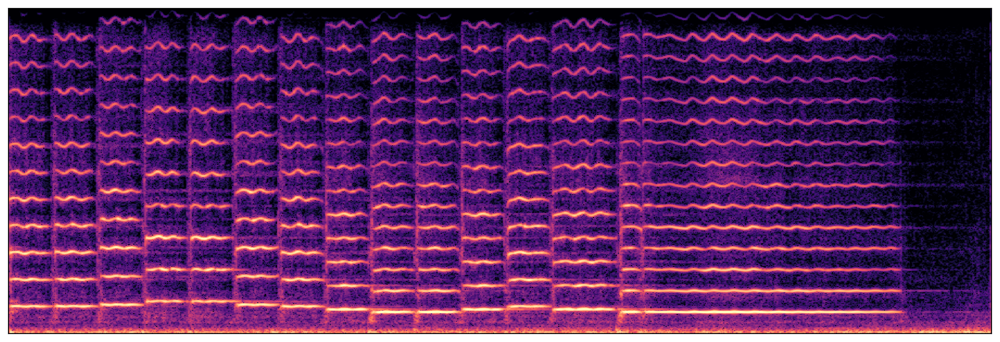

In [14]:
instrument_id = INST_NAME_TO_ID_DICT[instrument_name]
midi_audio, midi_control_params, midi_synth_params, conditioning_df = synthesize_mono_midi(synthesis_generator, expression_generator, midi_file, instrument_id, output_dir=None, pitch_offset=pitch_offset, speed_rate=speed_rate)

plt.figure(figsize=(15,5))
plot_spec(midi_audio[0].numpy(), sr=16000)
plt.show()

## Adjusting Note Expression

In MIDI-DDSP, six note expression controls are designed and used to control the expressive performance, all in range of [0,1]. You can adjust them to edit the performance aspect of the MIDI synthesis:
 - Volume (`volume`): Controls overall volume of a note. (larger value -> larger volume)
 - Volume Fluctuation (`vol_fluc`): Controls the extent of the volume changing in a note (crescendo & decrescendo or not). (larger value -> more extensive dynamic changing)
 - Volume Peak Position (`vol_peak_pos`): Controls the volume changing in a note (crescendo & decrescendo, together with amplitude_std). (larger value -> later reach maximum volume)
 - Attack Noise (`attack_noise`): Controls the extent of note attack (strong or soft). (larger value -> larger attack)
 - Brightness (`brightness`): Controls the timbre of a note. (larger value -> brighter / more amplitude on higher harmonics)
 - Vibrato (`vibrato`): Controls the extend of the vibrato of a note. (larger value -> larger vibrato extend)

 

In [8]:
#@markdown Run this cell to get an editable table for adjusting note expression.
#@markdown The values shown are predicted by note expression control generator.
#@markdown Each row is a note. Double click the item in the table and enter the value, click anywhere else to save the change. 

#@markdown You can also edit the note pitch and length just as editing a MIDI sequence.
#@markdown To add a note or remove a note, click "Add Row" and "Remove Row" on the upper left corner.

#@markdown After edit, the table is changed automatically and you can run the synthesize cell below the next cell to synthesize the result. 
#@markdown **Run this cell again will reset the table to the initial value.**

qgrid_widget = qgrid.show_grid(conditioning_df_to_edit_df(conditioning_df), show_toolbar=True)
qgrid_widget

QgridWidget(grid_options={'fullWidthRows': True, 'syncColumnCellResize': True, 'forceFitColumns': True, 'defaultColumnWidth': 150, 'rowHeight': 28, 'enableColumnReorder': False, 'enableTextSelectionOnCells': True, 'editable': True, 'autoEdit': False, 'explicitInitialization': True, 'maxVisibleRows': 15, 'minVisibleRows': 8, 'sortable': True, 'filterable': True, 'highlightSelectedCell': False, 'highlightSelectedRow': True, 'boldIndex': True}, id='d1788c65-aa32-465d-b119-b8d7beed5e90', precision=5, show_toolbar=True)

In [12]:
pitches = conditioning_df['pitch']
for i in range(len(pitches)):
    if pitches[i] != 0:
        pitches[i] = 76


Generating:   0%|          | 0/2712 [00:00<?, ?it/s]

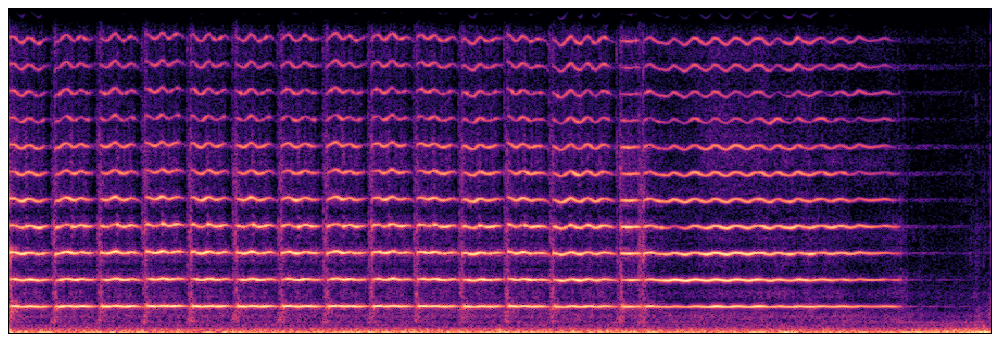

In [13]:
#@markdown Run this cell to synthesize with edited note expression controls.

conditioning_df_changed = conditioning_df
midi_audio, midi_control_params, midi_synth_params = conditioning_df_to_audio(synthesis_generator, conditioning_df_changed, tf.constant([instrument_id]), display_progressbar=True)
plt.figure(figsize=(15,5))
plot_spec(midi_audio[0].numpy(), sr=16000)
plt.show()

## Bach Chorales Synthesis

Generating:   0%|          | 0/9750 [00:00<?, ?it/s]

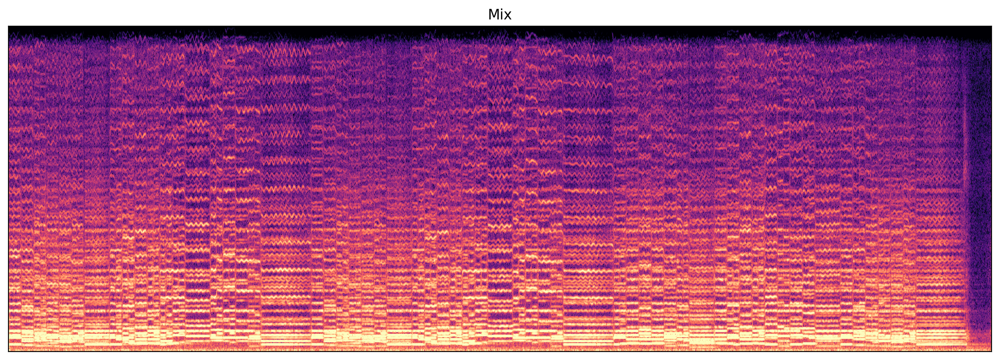

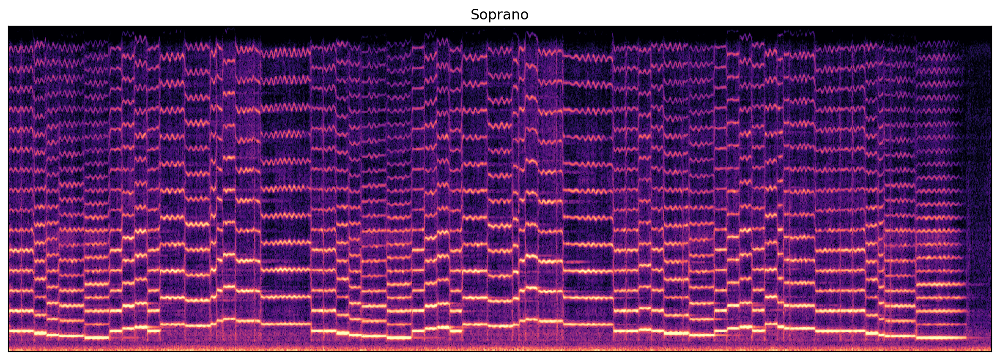

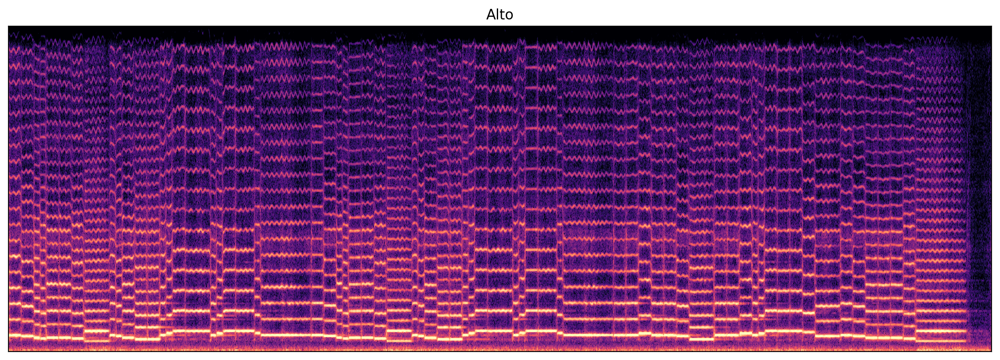

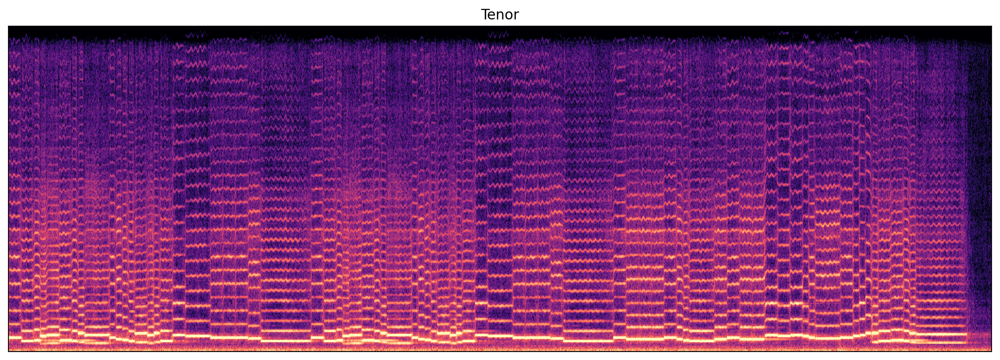

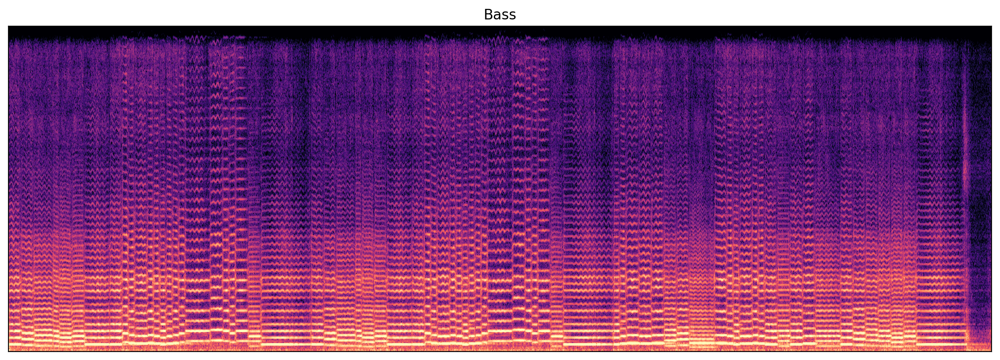

In [10]:
#@markdown Besides synthesizing monophonic MIDI, MIDI-DDSP can also synthesizing multi-track MIDI.
#@markdown Running this cell to synthesis quartet of [4-part Bach Chorales](https://en.wikipedia.org/wiki/List_of_chorale_harmonisations_by_Johann_Sebastian_Bach).

#@markdown You can synthesize any Bach Chorales by typing in piece number to `piece_number` below. A full list of bach chorales available can be found [here](https://github.com/cuthbertLab/music21/tree/master/music21/corpus/bach).

#@markdown We provide three quartet settings, string, woodwind and brass wind. You can change the ensemble by selecting from the drop down menu of `ensemble`.


piece_number = 'bwv227.1' #@param {type:"string"}

ensemble = 'string_set' #@param ['string_set', 'woodwind_set', 'brasswind_set']

score = music21.corpus.parse(f'bach/{piece_number}')
score.write('midi', fp=f'./{piece_number}.mid')
midi_file = f'./{piece_number}.mid'
midi_audio_mix, midi_audio_all, midi_control_params, midi_synth_params, conditioning_df_all = synthesize_bach(
    synthesis_generator, 
    expression_generator, 
    midi_file, 
    quartet_set=ensemble, 
    pitch_offset=0, 
    speed_rate=1, 
    output_dir='./', 
    gain_adjust_db_dict=GAIN_ADJUST_DB_DICT[ensemble])

part_name = list(GAIN_ADJUST_DB_DICT[ensemble].keys())
plt.figure(figsize=(15,5))
plot_spec(midi_audio_mix, sr=16000, title='Mix')
plt.show()

for i in range(len(midi_audio_all)):
    plt.figure(figsize=(15,5))
    plot_spec(midi_audio_all[i], sr=16000, title=part_name[i])
    plt.show()

## Pitch Bend by Editing Synthesis Parameters

In [16]:
#@markdown Run this cell to generate a pitch bend by editing synthesis parameters.
#@markdown You can double-click the cell to see how we do it in the code.
#@markdown This is just an example. 
#@markdown We encourage you to come up with smarter ways to smooth the connection and 
#@markdown crazy ways to play with the synthesis parameters :).

# First define functions to generate pitch bend. 
# You can come up with your own way of edit pitch or
# other synthesis parameters.
# check the values of pitch_offset and speed_rate. 
pitch_offset =  0
speed_rate = 1
def get_pitch_bend(start_value, end_value, length, power=4,offset_1=-1,bend_type='exp'):
    if bend_type=='exp':
        if start_value <= end_value:
            value = start_value + (np.power(np.linspace(0.0, 1.0, num=length)+offset_1, power)-offset_1) * (end_value-start_value)
        return value
    elif bend_type=='linear':
        return np.linspace(start_value, end_value, length)

# First run the MIDI-DDSP to get the synthesis parameters predicted
# You don't need to run this if you already have the synthesis parameter prediction.
midi_file = r'./midi-ddsp/midi_example/ode_to_joy.mid'
instrument_name = 'violin'
instrument_id = INST_NAME_TO_ID_DICT[instrument_name]
midi_audio, midi_control_params, midi_synth_params, conditioning_df = synthesize_mono_midi(synthesis_generator, expression_generator, midi_file, instrument_id, output_dir=None, pitch_offset=pitch_offset, speed_rate=speed_rate)

# Assume we want to add a pitch bend in the middle of two notes. 
# The first note ends at frame 368 while the next note start at the frame 375

prev_note_off = 368
next_note_on = 375
f0_ori = midi_synth_params['f0_hz'][0,...,0]
amps_ori = midi_synth_params['amplitudes'].numpy()[0,...,0]
noise_ori = midi_synth_params['noise_magnitudes'].numpy()
hd_ori = midi_synth_params['harmonic_distribution'].numpy()

# Edit the f0 to add the pitch bend, starting from 
# 20 frames before the previous note off to 50 frames after next note on.
edit_frame_start = prev_note_off-20
edit_frame_end = next_note_on+50
edit_frame_duration = edit_frame_end - edit_frame_start

f0_changed = tf.concat([f0_ori[:edit_frame_start], 
            get_pitch_bend(f0_ori[edit_frame_start], 
                    f0_ori[edit_frame_end], 
                    (edit_frame_end)-(edit_frame_start), 
                    power=7, 
                    bend_type='exp'), 
            f0_ori[edit_frame_end:]], axis=0)
f0_changed = f0_changed[tf.newaxis, ..., tf.newaxis]

Generating:   0%|          | 0/2712 [00:00<?, ?it/s]

In [40]:
for i in range(f0_changed.shape[1]):
    if f0_changed[0][i] > 5:
        f0_changed[0][i] = 660

TypeError: 'tensorflow.python.framework.ops.EagerTensor' object does not support item assignment

In [ ]:
# For other synthesis parameters, use that from the start of the next note 
# to replace the connection of notes. 
# We also need to avoid the onset of the next note, 
# thus that is the reason we use "next_note_on+5" as the start.
amps_changed = amps_ori
amps_changed[edit_frame_start:edit_frame_end] = amps_ori[next_note_on+5:next_note_on+edit_frame_duration+5]
amps_changed = amps_changed[tf.newaxis, ..., tf.newaxis]
noise_changed = noise_ori
noise_changed[0,edit_frame_start:edit_frame_end,:] = noise_ori[0,next_note_on+5:next_note_on+edit_frame_duration+5,:]
hd_changed = hd_oriz
hd_changed[0,edit_frame_start:edit_frame_end,:] = hd_changed[0,next_note_on+5:next_note_on+edit_frame_duration+5,:]

# Resynthesis the audio using DDSP
processor_group = get_process_group(midi_synth_params['amplitudes'].shape[1], use_angular_cumsum=True)
midi_audio_changed = processor_group({'amplitudes': amps_changed,
                        'harmonic_distribution': hd_changed,
                        'noise_magnitudes': noise_changed,
                        'f0_hz': f0_changed,},
                          verbose=False)
if synthesis_generator.reverb_module is not None:
    midi_audio_changed = synthesis_generator.reverb_module(midi_audio_changed, reverb_number=instrument_id, training=False)

plt.figure(figsize=(15,5))
# Just play the first 4 seconds
plot_spec(midi_audio[0].numpy()[:4*16000], sr=16000, title='Original')
plt.show()
plt.figure(figsize=(15,5))
plot_spec(midi_audio_changed[0].numpy()[:4*16000], sr=16000, title='Add pitch bend')
plt.show()

In [19]:
f0_ori[:100]

<tf.Tensor: shape=(100,), dtype=float32, numpy=
array([663.4573 , 663.4573 , 663.4573 , 662.6911 , 661.54376, 660.7801 ,
       660.017  , 659.6361 , 658.4941 , 657.73364, 657.35376, 656.2157 ,
       655.0796 , 655.0796 , 653.5677 , 653.19025, 653.5677 , 653.5677 ,
       653.19025, 653.19025, 653.19025, 653.19025, 652.8133 , 653.9454 ,
       653.5677 , 653.5677 , 653.9454 , 654.32336, 654.7012 , 655.4581 ,
       655.8369 , 656.97437, 658.1138 , 658.8743 , 658.8743 , 659.6361 ,
       660.7801 , 661.54376, 662.30865, 663.07404, 663.4573 , 663.8407 ,
       664.6079 , 664.992  , 664.992  , 665.76056, 665.76056, 665.76056,
       665.37634, 664.992  , 664.992  , 664.6079 , 663.8407 , 663.4573 ,
       662.6911 , 662.30865, 661.54376, 660.017  , 658.8743 , 658.4941 ,
       657.73364, 656.2157 , 656.5949 , 655.8369 , 655.4581 , 654.7012 ,
       653.9454 , 653.5677 , 653.19025, 653.19025, 652.8133 , 652.8133 ,
       652.8133 , 652.8133 , 652.8133 , 652.8133 , 653.5677 , 653.19025,
   

## Multi-track MIDI Synthesis

Generating:   0%|          | 0/2712 [00:00<?, ?it/s]

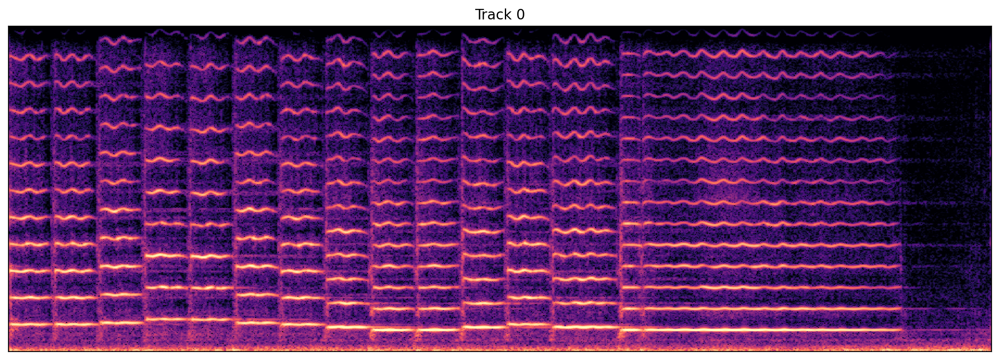

In [12]:
#@markdown Run this cell to upload and synthesize any multi-track MIDI.

#@markdown For midi programs that are not supported by MIDI-DDSP, we will use [FluidSynth](https://www.fluidsynth.org/) to synthesize the track.
#@markdown For midi programs supported by MIDI-DDSP, it will only synthesize a monophonic performance. 
#@markdown That is, for a polyphonic track, only a polyphonic note sequence will be synthesized.

pitch_offset =  0#@param {type:"integer"}

speed_rate =  1#@param {type:"number", min:0}

# !!! You should load a multi-track MIDI file with mido or something for this cell to do anything useful.
# midi_file = ...
# midi_file = upload_midi()[0] # this is colab specific

output = synthesize_midi(synthesis_generator, expression_generator, midi_file,
              pitch_offset=pitch_offset, speed_rate=speed_rate,
              output_dir=r'./',
              use_fluidsynth=True,
              sf2_path='./FluidR3_GM.sf2',
              display_progressbar=True)

#plot_spec(output['midi_audio_mix'], sr=16000, title='Mix')

for i in range(len(output['stem_audio'])):
    plt.figure(figsize=(15,5))
    plot_spec(output['stem_audio'][i], sr=16000, title=f'Track {i}')
    plt.show()